# Chapter 03: Linear Regression 

## Table of Contents:
* [Simple Linear Regression](#simple-linear-regression)
* [Multiple Linear Regression](#multiple-linear-regression)
* [Chapter 3 Lab](#lab-header)

### Simple Linear Regression <a class="anchor" id="simple-linear-regression"></a>

We will work on the Boston Housing Dataset

In [67]:
import pandas as pd
import os.path as osp
import statsmodels.api as sm
import statsmodels.tools as smtools
import statsmodels.stats as smstats
import numpy as np
import scipy.stats as stats
datasets_path = osp.join('../datasets')

In [35]:
boston = pd.read_csv(osp.join(datasets_path, 'boston.csv'), index_col=0)

In [36]:
boston.head()

,crim,zn,indus,chas,nox,rm,age,dis,rad,tax,ptratio,black,lstat,medv
1,0.00632,18.0,2.31,0,0.538,6.575,65.2,4.0900,1,296,15.3,396.90,4.98,24.0
2,0.02731,0.0,7.07,0,0.469,6.421,78.9,4.9671,2,242,17.8,396.90,9.14,21.6
3,0.02729,0.0,7.07,0,0.469,7.185,61.1,4.9671,2,242,17.8,392.83,4.03,34.7
4,0.03237,0.0,2.18,0,0.458,6.998,45.8,6.0622,3,222,18.7,394.63,2.94,33.4
5,0.06905,0.0,2.18,0,0.458,7.147,54.2,6.0622,3,222,18.7,396.90,5.33,36.2


In [37]:
predictor = smtools.tools.add_constant(boston['lstat'])
target = boston['medv']
lm = sm.OLS(target, predictor)
fitted_model = lm.fit()

In [38]:
fitted_model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                   medv   R-squared:                       0.544
Model:                            OLS   Adj. R-squared:                  0.543
Method:                 Least Squares   F-statistic:                     601.6
Date:                Fri, 08 May 2020   Prob (F-statistic):           5.08e-88
Time:                        17:09:34   Log-Likelihood:                -1641.5
No. Observations:                 506   AIC:                             3287.
Df Residuals:                     504   BIC:                             3295.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         34.5538      0.563     61.415      0.000      33.448      35.659
lstat         -0.9500      0.039    -24.528      0.000      -1.026      -0.874
==============================================================================
Omnibus:                      137.043   Durbin-Watson:                   0.892
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              291.373
Skew:                           1.453   Prob(JB):                     5.36e-64
Kurtosis:                       5.319   Cond. No.                         29.7
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [39]:
y_hat = fitted_model.predict(np.array([[1,5], [1,10], [1,15]]))
y_hat

array([29.80359411, 25.05334734, 20.30310057])

In [40]:
def predict_with_intervals(model, y_hat, predictor, target, percent = 0.95):
    '''
        model: RegressionResult
        y_hat: predictions 
        predictor: x train values
        target: y train values
        percent: percentage of confidence
    '''
    sum_of_squared_residuals = np.sum((model.predict(predictor) - target) ** 2)
    stdev = np.sqrt(1/(len(target) - 2) * sum_of_squared_residuals)
    percentile = 1 - (1 - percent) / 2
    normal = stats.norm.ppf(percentile)
    y_hat = y_hat.tolist()
    lwr = []
    upr = []
    for y in y_hat:
        lwr.append(y-normal*stdev)
        upr.append(y+normal*stdev)

    return pd.DataFrame({
        'fit': y_hat,
        'lwr': lwr,
        'upr': upr
    })

In [41]:
predict_with_intervals(fitted_model, y_hat, predictor, target)

,fit,lwr,upr
0,29.803594,17.620928,41.986261
1,25.053347,12.870681,37.236014
2,20.303101,8.120434,32.485767


In [42]:
import matplotlib.pyplot as plt
%matplotlib inline

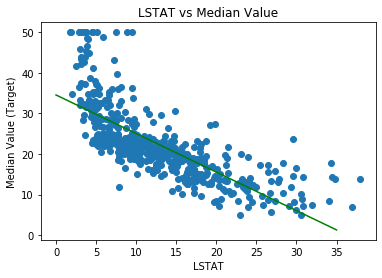

In [43]:
plt.scatter(x= predictor['lstat'], y=target)
x = np.linspace(0,35,35)
plt.plot(x, fitted_model.params['const'] + x * fitted_model.params['lstat'], '-g')
plt.title('LSTAT vs Median Value')
plt.xlabel('LSTAT')
plt.ylabel('Median Value (Target)');

In [44]:
from statsmodels.stats.outliers_influence import OLSInfluence
outlier_analysis = OLSInfluence(fitted_model)

Text(0, 0.5, 'Studentized Residual')

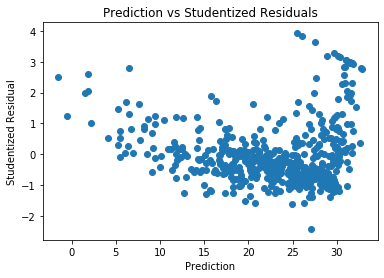

In [45]:
plt.scatter(x= fitted_model.predict(predictor), y=outlier_analysis.resid_studentized_internal)
plt.title('Prediction vs Studentized Residuals')
plt.xlabel('Prediction')
plt.ylabel('Studentized Residual')

Theres evidence of non-linearity in the data!

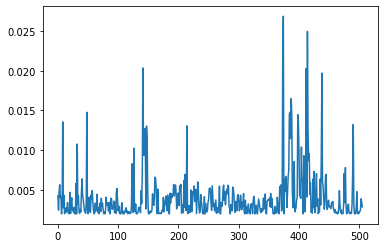

In [46]:
# let's get the leverage of each datapoint
leverage = outlier_analysis.hat_matrix_diag
plt.plot(leverage)

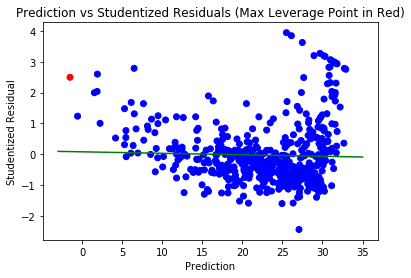

In [47]:
plt.scatter(x= fitted_model.predict(predictor),
            y=outlier_analysis.resid_studentized_internal,
           c=np.where(leverage!=np.max(leverage), 'b', 'r'))
x = np.linspace(-3,35,leverage.shape[0])
b, m = np.polynomial.polynomial.polyfit(x, y = outlier_analysis.resid_studentized_internal, deg=1)
plt.plot(x, b + x * m, c='g')
plt.title('Prediction vs Studentized Residuals (Max Leverage Point in Red)')
plt.xlabel('Prediction')
plt.ylabel('Studentized Residual');

### Multiple Linear Regression <a class="anchor" id="multiple-linear-regression"></a>
Let's use more predictors.
We'll add the age feature.

In [48]:
predictor = smtools.tools.add_constant(boston[['lstat', 'age']])
target = boston['medv']
mlm = sm.OLS(target, predictor)
fitted_model = mlm.fit()
fitted_model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                   medv   R-squared:                       0.551
Model:                            OLS   Adj. R-squared:                  0.549
Method:                 Least Squares   F-statistic:                     309.0
Date:                Fri, 08 May 2020   Prob (F-statistic):           2.98e-88
Time:                        17:09:35   Log-Likelihood:                -1637.5
No. Observations:                 506   AIC:                             3281.
Df Residuals:                     503   BIC:                             3294.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         33.2228      0.731     45.458      0.000      31.787      34.659
lstat         -1.0321      0.048    -21.416      0.000      -1.127      -0.937
age            0.0345      0.012      2.826      0.005       0.011       0.059
==============================================================================
Omnibus:                      124.288   Durbin-Watson:                   0.945
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              244.026
Skew:                           1.362   Prob(JB):                     1.02e-53
Kurtosis:                       5.038   Cond. No.                         201.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

We get a slim improvement in performance, lets visualize in a 3D plot.

In [114]:
import plotly.express as px
import plotly.graph_objects as go

df = pd.concat([predictor, target], axis=1)
fig = px.scatter_3d(df, x='lstat', y='age', z='medv', color='medv')
fig.show()

In [115]:
x, y = np.meshgrid(np.linspace(1,40,506), np.linspace(1,100,506))
z = x * fitted_model.params['lstat'] + y * fitted_model.params['age'] + fitted_model.params['const']

fig = go.Figure(data=[go.Surface(z=z, x=x, y=y),
                      go.Scatter3d(x=df['lstat'], y=df['age'], z=df['medv'], \
                                   mode='markers', marker = dict(color=df['medv']))])
fig.update_layout(
    title_text='Age and Lstat vs Median Value plus Regression Plain')
fig.show()

Now let's try with all the avaliable predictors

,crim,zn,indus,chas,nox,rm,age,dis,rad,tax,ptratio,black,lstat
1,0.00632,18.0,2.31,0,0.538,6.575,65.2,4.0900,1,296,15.3,396.90,4.98
2,0.02731,0.0,7.07,0,0.469,6.421,78.9,4.9671,2,242,17.8,396.90,9.14
3,0.02729,0.0,7.07,0,0.469,7.185,61.1,4.9671,2,242,17.8,392.83,4.03
4,0.03237,0.0,2.18,0,0.458,6.998,45.8,6.0622,3,222,18.7,394.63,2.94
5,0.06905,0.0,2.18,0,0.458,7.147,54.2,6.0622,3,222,18.7,396.90,5.33
...,...,...,...,...,...,...,...,...,...,...,...,...,...
502,0.06263,0.0,11.93,0,0.573,6.593,69.1,2.4786,1,273,21.0,391.99,9.67
503,0.04527,0.0,11.93,0,0.573,6.120,76.7,2.2875,1,273,21.0,396.90,9.08
504,0.06076,0.0,11.93,0,0.573,6.976,91.0,2.1675,1,273,21.0,396.90,5.64
505,0.10959,0.0,11.93,0,0.573,6.794,89.3,2.3889,1,273,21.0,393.45,6.48


In [120]:
predictor = smtools.tools.add_constant(boston.drop(['medv'], axis=1))
target = boston['medv']
mlm = sm.OLS(target, predictor)
fitted_model = mlm.fit()
fitted_model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                   medv   R-squared:                       0.741
Model:                            OLS   Adj. R-squared:                  0.734
Method:                 Least Squares   F-statistic:                     108.1
Date:                Fri, 08 May 2020   Prob (F-statistic):          6.72e-135
Time:                        18:37:52   Log-Likelihood:                -1498.8
No. Observations:                 506   AIC:                             3026.
Df Residuals:                     492   BIC:                             3085.
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         36.4595      5.103      7.144      0.000      26.432      46.487
crim          -0.1080      0.033     -3.287      0.001      -0.173      -0.043
zn             0.0464      0.014      3.382      0.001       0.019       0.073
indus          0.0206      0.061      0.334      0.738      -0.100       0.141
chas           2.6867      0.862      3.118      0.002       0.994       4.380
nox          -17.7666      3.820     -4.651      0.000     -25.272     -10.262
rm             3.8099      0.418      9.116      0.000       2.989       4.631
age            0.0007      0.013      0.052      0.958      -0.025       0.027
dis           -1.4756      0.199     -7.398      0.000      -1.867      -1.084
rad            0.3060      0.066      4.613      0.000       0.176       0.436
tax           -0.0123      0.004     -3.280      0.001      -0.020      -0.005
ptratio       -0.9527      0.131     -7.283      0.000      -1.210      -0.696
black          0.0093      0.003      3.467      0.001       0.004       0.015
lstat         -0.5248      0.051    -10.347      0.000      -0.624      -0.425
==============================================================================
Omnibus:                      178.041   Durbin-Watson:                   1.078
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              783.126
Skew:                           1.521   Prob(JB):                    8.84e-171
Kurtosis:                       8.281   Cond. No.                     1.51e+04
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.51e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

Let's check out the Variance Inflation Factor

In [139]:
for idx in range(len(predictor.columns)):
    vif = smstats.outliers_influence.variance_inflation_factor(predictor.to_numpy(), idx)
    print('{} VIF = {}'.format(predictor.columns[idx], vif))

const VIF = 585.2652379423121
crim VIF = 1.792191547433241
zn VIF = 2.2987581787494418
indus VIF = 3.9915964183460315
chas VIF = 1.0739953275537883
nox VIF = 4.393719847577493
rm VIF = 1.9337444357832565
age VIF = 3.1008255128153364
dis VIF = 3.9559449063727263
rad VIF = 7.484496335274472
tax VIF = 9.00855394759707
ptratio VIF = 1.7990840492488978
black VIF = 1.348521076406375
lstat VIF = 2.9414910780919366


### Lab Chapter 3 <a class="anchor" id="lab-header"></a>

Let's play with some categorical predictors.